In [1]:
import pandas as pd
import numpy as np
from baseball_scraper import statcast
import seaborn as sns

In [2]:
data = statcast(start_dt = '2024-01-01', end_dt='2024-03-27')

This is a large query, it may take a moment to complete
Completed sub-query from 2024-01-01 to 2024-03-27


In [3]:
data.columns

Index(['index', 'pitch_type', 'game_date', 'release_speed', 'release_pos_x',
       'release_pos_z', 'player_name', 'batter', 'pitcher', 'events',
       'description', 'spin_dir', 'spin_rate_deprecated',
       'break_angle_deprecated', 'break_length_deprecated', 'zone', 'des',
       'game_type', 'stand', 'p_throws', 'home_team', 'away_team', 'type',
       'hit_location', 'bb_type', 'balls', 'strikes', 'game_year', 'pfx_x',
       'pfx_z', 'plate_x', 'plate_z', 'on_3b', 'on_2b', 'on_1b',
       'outs_when_up', 'inning', 'inning_topbot', 'hc_x', 'hc_y',
       'tfs_deprecated', 'tfs_zulu_deprecated', 'fielder_2', 'umpire', 'sv_id',
       'vx0', 'vy0', 'vz0', 'ax', 'ay', 'az', 'sz_top', 'sz_bot',
       'hit_distance_sc', 'launch_speed', 'launch_angle', 'effective_speed',
       'release_spin_rate', 'release_extension', 'game_pk', 'pitcher.1',
       'fielder_2.1', 'fielder_3', 'fielder_4', 'fielder_5', 'fielder_6',
       'fielder_7', 'fielder_8', 'fielder_9', 'release_pos_y',
     

In [4]:
data['description'].value_counts()

ball                       7848
hit_into_play              5270
called_strike              3920
swinging_strike            3749
foul                       3448
blocked_ball                319
foul_tip                    191
swinging_strike_blocked     127
hit_by_pitch                 99
foul_bunt                    23
missed_bunt                   5
pitchout                      1
Name: description, dtype: int64

In [5]:
data['bb_type'].value_counts()

ground_ball    2328
fly_ball       1413
line_drive     1200
popup           329
Name: bb_type, dtype: int64

Detailed Context
Positive Outcomes:

swinging_strike: Indicates a missed swing, which is good for the pitcher.

swinging_strike_blocked: Similar to a swinging strike, with the added note that the catcher blocked the ball.

called_strike: The batter did not swing at a pitch in the strike zone, which counts as a strike.

popup: Often results in an easy out.

ground_ball: Often leads to outs, especially if fielded cleanly and turned into a double play.

Neutral Outcomes:

foul: Counts as a strike but cannot be the third strike unless it is a bunt attempt.

foul_tip: Similar to a foul but typically caught by the catcher, counting as a strike.

foul_bunt: A failed bunt attempt that goes foul, counts as a strike.

missed_bunt: A missed attempt to bunt, counts as a strike.

blocked_ball: Prevents base runners from advancing but still counts as a ball.


pitchout: Intentionally outside to prevent a steal; counts as a ball but strategically neutral.

Negative Outcomes:


hit_into_play: The ball is put into play, potentially leading to a hit or an out.

ball: A pitch outside the strike zone that is not swung at, unfavorable for the pitcher.

hit_by_pitch: The batter is awarded first base, definitely unfavorable for the pitcher.

line_drive: Often results in hits due to the ball being hit hard and straight.

fly_ball: Can result in outs but also in hits, especially if it goes for a home run.

These explanations should help you better understand the context and outcomes of each value, allowing for more accurate categorization in your analysis.


In [21]:
pitch_related_vars = [
    "pitch_type",           # The type of pitch derived from Statcast.
    "release_speed",        # Pitch velocities reported out-of-hand.
    "release_pos_x",        # Horizontal release position of the ball measured in feet from the catcher's perspective.
    "release_pos_z",        # Vertical release position of the ball measured in feet from the catcher's perspective.
    "pfx_x",                # Horizontal movement in feet from the catcher's perspective.
    "pfx_z",                # Vertical movement in feet from the catcher's perspective.
    "plate_x",              # Horizontal position of the ball when it crosses home plate from the catcher's perspective.
    "plate_z",              # Vertical position of the ball when it crosses home plate from the catcher's perspective.
    "vx0",                  # The velocity of the pitch in feet per second in x-dimension, determined at y=50 feet.
    "vy0",                  # The velocity of the pitch in feet per second in y-dimension, determined at y=50 feet.
    "vz0",                  # The velocity of the pitch in feet per second in z-dimension, determined at y=50 feet.
    "ax",                   # The acceleration of the pitch in feet per second per second in x-dimension, determined at y=50 feet.
    "ay",                   # The acceleration of the pitch in feet per second per second in y-dimension, determined at y=50 feet.
    "az",                   # The acceleration of the pitch in feet per second per second in z-dimension, determined at y=50 feet.
    "release_spin_rate",         # Spin rate of pitch tracked by Statcast.
    "release_extension",    # Release extension of pitch in feet as tracked by Statcast.
    "spin_axis",            # The Spin Axis in the 2D X-Z plane in degrees from 0 to 360.
    "p_throws",
     "type"
    #"launch_speed",
    #"launch_angle",
    #"pitcher",
    #"launch_speed_angle"
]
             

In [14]:
data['type'].value_counts()

S    11463
B     8267
X     5270
Name: type, dtype: int64

In [22]:

# Assuming 'data' is your DataFrame
def categorize_pitch_outcome(row):
    # Define positive outcomes
    positive_descriptions = [
        'swinging_strike', 'swinging_strike_blocked', 'called_strike'
    ]
    positive_bb_types = ['popup']
    
    # Define neutral outcomes
    neutral_descriptions = [
        'foul', 'foul_tip', 'foul_bunt', 'missed_bunt', 
        'blocked_ball', 'pitchout'
    ]
    
    # Define negative outcomes
    negative_descriptions = ['hit_into_play', 'ball', 'hit_by_pitch']
    negative_bb_types = ['line_drive', 'fly_ball', 'ground_ball']

    if row['description'] in positive_descriptions:
        return 'positive'
    elif row['description'] in neutral_descriptions:
        return 'neutral'
    elif row['description'] in negative_descriptions or row['bb_type'] in negative_bb_types:
        return 'negative'
    else:
        return 'neutral'  # Default to neutral if no match is found

# Apply the function to each row
data['pitch_outcome'] = data.apply(categorize_pitch_outcome, axis=1)
X = data[pitch_related_vars]
y = data['pitch_outcome']

In [23]:
data1 = pd.concat([X, y], axis=1)
data1 = data1.dropna(subset = ['release_speed'])

In [24]:
data1.shape

(15648, 20)

In [25]:
# making numeric columns positive
num_df = data1.select_dtypes(include=['number'])
abs_num_df = num_df.abs()
data1 = abs_num_df.join(data1.select_dtypes(exclude=['number']))


In [26]:
data1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15648 entries, 280 to 24955
Data columns (total 20 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   release_speed      15648 non-null  float64
 1   release_pos_x      15648 non-null  float64
 2   release_pos_z      15648 non-null  float64
 3   pfx_x              15648 non-null  float64
 4   pfx_z              15648 non-null  float64
 5   plate_x            15648 non-null  float64
 6   plate_z            15648 non-null  float64
 7   vx0                15648 non-null  float64
 8   vy0                15648 non-null  float64
 9   vz0                15648 non-null  float64
 10  ax                 15648 non-null  float64
 11  ay                 15648 non-null  float64
 12  az                 15648 non-null  float64
 13  release_spin_rate  15631 non-null  float64
 14  release_extension  15645 non-null  float64
 15  spin_axis          15631 non-null  float64
 16  pitch_type         1

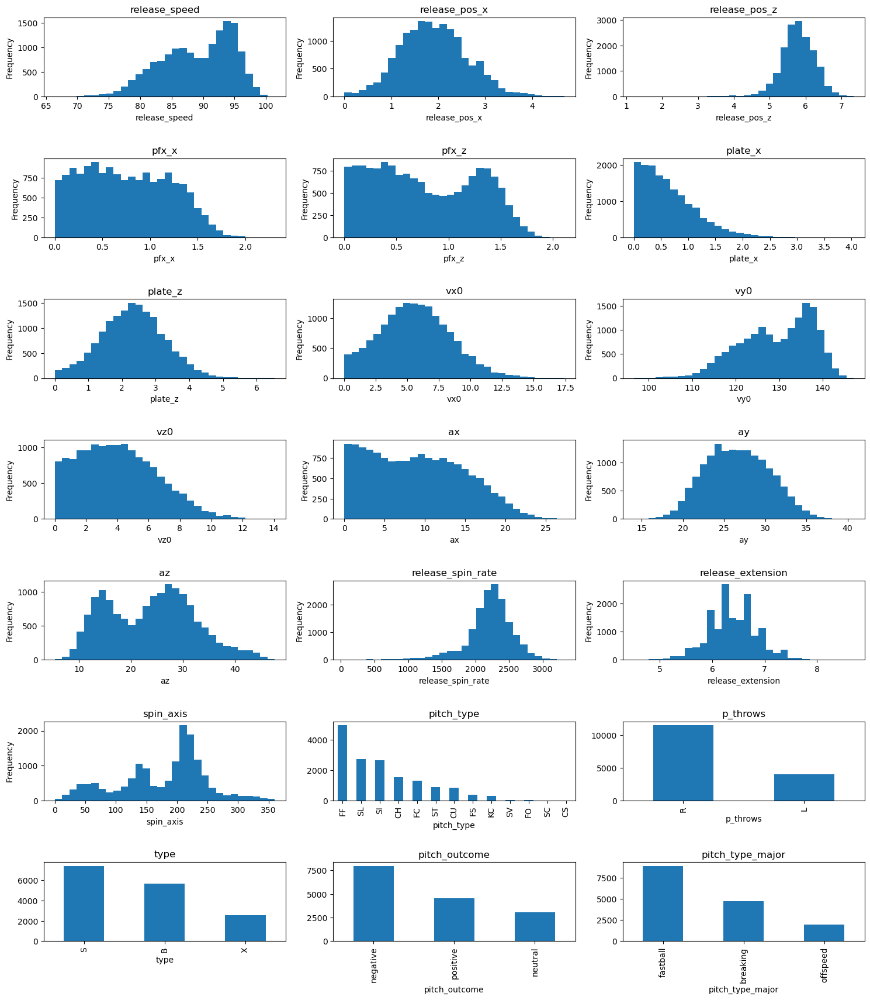

In [251]:
#plotting hist
import matplotlib.pyplot as plt
num_columns = data1.shape[1]
fig, axes = plt.subplots(nrows=num_columns, ncols=3, figsize=(15,50))

axes = axes.flatten()
for i, column in enumerate(data1.columns):
    if data1[column].dtype in ['float64', 'int64']:
        data1[column].plot(kind='hist', ax=axes[i], title=column, bins=30)
    elif data1[column].dtype == 'object':
        data1[column].value_counts().plot(kind='bar', ax=axes[i], title=column)
    else:
        axes[i].text(0.5, 0.5, 'Unsupported dtype', horizontalalignment='center', verticalalignment='center')
    axes[i].set_xlabel(column)

for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])
# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()

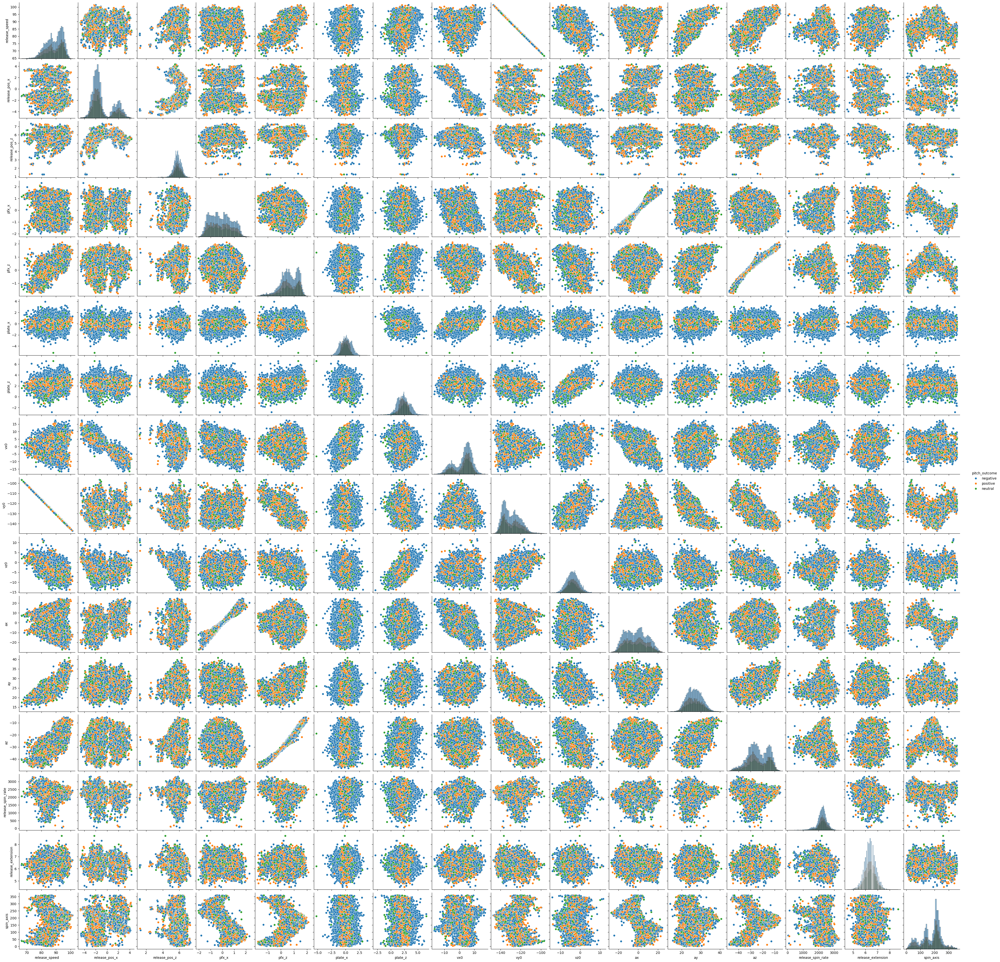

In [30]:
#sns.pairplot(data1, diag_kind="hist", hue = 'pitch_outcome')

<Axes: xlabel='pitch_outcome', ylabel='Count'>

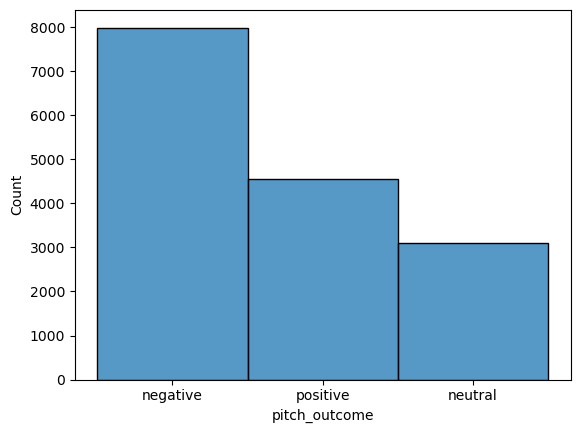

In [17]:
sns.histplot(data1['pitch_outcome'], kde=False)

Calculating MI(Y,X)

In [86]:
fastball = ["FF","SI","FC"]
offspeed = ["CH","SC","FS","FO"]
breaking = ["CU","KC","CS","SL","ST","SV","KN"]

def map_pitch_type(pitch):
    if pitch in fastball:
        return 'fastball'
    elif pitch in offspeed:
        return 'offspeed'
    elif pitch in breaking:
        return 'breaking'
    else:
        return 'other'

# Applying the function to create a new column with the categories
data1['pitch_type_major'] = data1['pitch_type'].apply(map_pitch_type)

In [95]:
#data1.drop(columns=['pitch_major'], inplace=True)

In [88]:
data1.dropna(inplace=True)

In [98]:
from sklearn.preprocessing import LabelEncoder
data2 = pd.DataFrame()
categorical_columns = ["pitch_type", "p_throws","pitch_type_major"]
target_columns = ["type","pitch_outcome"]

numeric_columns = data1.columns.difference(categorical_columns + target_columns)

#print(numeric_columns)
# Discretize each numeric column into quintiles
for column in numeric_columns:
    #print(column)
    data2[column] = pd.qcut(data1[column], q=5, labels=[1, 2, 3, 4, 5])

le = LabelEncoder()

# Encode categorical columns and target columns
for column in categorical_columns + target_columns:
    data2[column] = le.fit_transform(data1[column])
    
for column in data2.columns:
    data2[column] = data2[column].astype('category')

data2.head()

,ax,ay,az,pfx_x,pfx_z,plate_x,plate_z,release_extension,release_pos_x,release_pos_z,...,release_spin_rate,spin_axis,vx0,vy0,vz0,pitch_type,p_throws,pitch_type_major,type,pitch_outcome
280,5,5,3,5,3,4,2,2,3,1,...,4,5,3,4,4,10,1,1,2,0
281,1,2,4,1,1,4,1,2,3,1,...,4,1,3,2,4,11,1,0,1,2
282,1,3,5,2,1,1,2,1,3,1,...,5,1,2,2,1,11,1,0,2,0
283,1,3,5,1,1,1,5,1,2,1,...,4,2,2,2,2,3,1,1,0,0
284,1,3,4,1,1,5,4,1,3,1,...,4,1,1,2,1,3,1,1,1,1


In [39]:
def calc_mi_v2(x,y, data):
    x_mod = [data[i] for i in x]
    y_mod = [data[i] for i in y]

    contingency_table = pd.crosstab(x_mod, y_mod)
    ce_table = contingency_table / np.expand_dims(contingency_table.sum(axis=1), axis=1)
    rowise_ce = np.apply_along_axis(entropy, 1, ce_table)
    marginal_prob_x = contingency_table.sum(axis=1) / contingency_table.sum().sum()
    ce = np.dot(marginal_prob_x, rowise_ce)

    marginal_prob_y = contingency_table.sum(axis=0) / contingency_table.sum().sum()
    e_y = entropy(marginal_prob_y)

    mi = e_y - ce
    return mi, ce_table

In [119]:
mi_list = []
x_list = []

x_vars = list(data2.columns[:-2])
x_vars.remove("pitch_type")

for i in x_vars:
    x_list.append(i)
    mi_list.append(calc_mi_v2([i],["pitch_outcome"],data2)[0])

print(len(x_list), len(mi_list))
single_mi_df = pd.DataFrame({"Variable":x_list, "Mutual Information":mi_list})
single_mi_df.sort_values(by = "Mutual Information", ascending=False)

18 18


,Variable,Mutual Information
5,plate_x,0.058971
6,plate_z,0.024637
13,vx0,0.003606
15,vz0,0.003405
2,az,0.002882
4,pfx_z,0.002434
10,release_speed,0.002151
17,pitch_type_major,0.002083
14,vy0,0.002055
12,spin_axis,0.001691


**TWO WAY**

In [129]:
import itertools
combinations = list(itertools.combinations(x_vars, 2))

mi_list = []
x_list = []

for i in combinations:
    x_list.append(i)
    mi_list.append(calc_mi_v2(i,["pitch_outcome"],data2)[0])

double_mi_df = pd.DataFrame({"Variable":x_list, "Mutual Information":mi_list})
double_mi_df.sort_values(by = "Mutual Information", ascending=False).head(20)

,Variable,Mutual Information
75,"(plate_x, plate_z)",0.091000
35,"(az, plate_x)",0.065179
86,"(plate_x, pitch_type_major)",0.064539
84,"(plate_x, vz0)",0.064453
62,"(pfx_z, plate_x)",0.064180
79,"(plate_x, release_speed)",0.064121
83,"(plate_x, vy0)",0.064016
82,"(plate_x, vx0)",0.063903
20,"(ay, plate_x)",0.063615
80,"(plate_x, release_spin_rate)",0.063410


# Removing Balls cause they are over inflated in negative type

In [126]:
data2_noball = data2[data2['type'] != 0 ]

In [127]:
data2_noball['type'].value_counts()

1    7401
2    2565
0       0
Name: type, dtype: int64

In [128]:
mi_list = []
x_list = []

x_vars = list(data2.columns[:-2])
x_vars.remove("pitch_type")

for i in x_vars:
    x_list.append(i)
    mi_list.append(calc_mi_v2([i],["pitch_outcome"],data2_noball)[0])

print(len(x_list), len(mi_list))
single_mi_df = pd.DataFrame({"Variable":x_list, "Mutual Information":mi_list})
single_mi_df.sort_values(by = "Mutual Information", ascending=False)

18 18


,Variable,Mutual Information
6,plate_z,0.015521
2,az,0.006444
4,pfx_z,0.006049
10,release_speed,0.005968
14,vy0,0.005955
5,plate_x,0.005519
17,pitch_type_major,0.005384
12,spin_axis,0.004270
1,ay,0.004112
11,release_spin_rate,0.002950


In [139]:
mi_list = []
x_list = []

for i in combinations:
    x_list.append(i)
    mi_list.append(calc_mi_v2(i,["pitch_outcome"],data2_noball)[0])

double_mi_df = pd.DataFrame({"Variable":x_list, "Mutual Information":mi_list})
double_mi_df.sort_values(by = "Mutual Information", ascending=False).head(20)

,Variable,Mutual Information
75,"(plate_x, plate_z)",0.027336
36,"(az, plate_z)",0.024209
63,"(pfx_z, plate_z)",0.022987
94,"(plate_z, vy0)",0.022673
90,"(plate_z, release_speed)",0.022593
97,"(plate_z, pitch_type_major)",0.022161
95,"(plate_z, vz0)",0.021902
21,"(ay, plate_z)",0.021645
92,"(plate_z, spin_axis)",0.020627
93,"(plate_z, vx0)",0.019885


By pitch types

In [151]:
data1 =data1[data1['pitch_type_major'] != 'other']

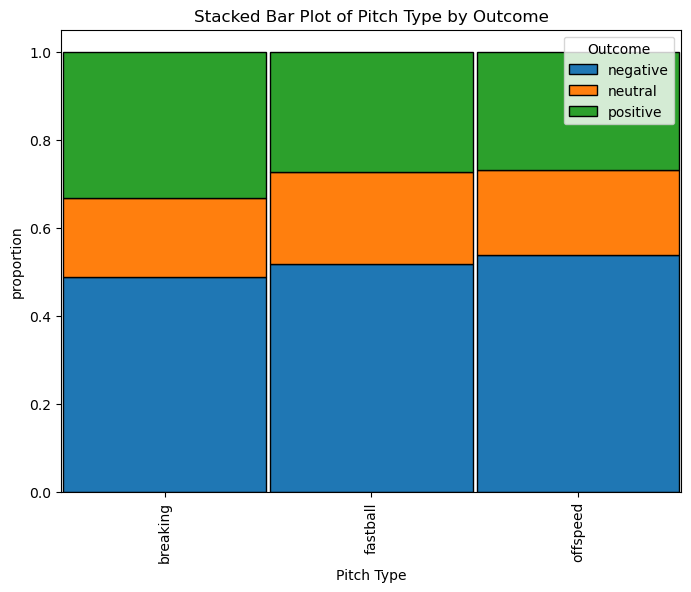

In [192]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a contingency table
contingency_table = data1.groupby(['pitch_type_major', 'pitch_outcome']).size().unstack(fill_value=0)
contingency_table  = contingency_table.div(contingency_table.sum(axis=1), axis=0)

# Plotting stacked bar plot
contingency_table.plot(kind='bar', stacked=True, figsize=(8,6), width = 0.98, edgecolor = 'black')
plt.margins(x=0.01, tight=True)
plt.xlim(-0.5, len(contingency_table) - 0.5)
plt.xlabel("Pitch Type")
plt.ylabel("proportion")
plt.title("Stacked Bar Plot of Pitch Type by Outcome")
plt.legend(title="Outcome")
plt.show()



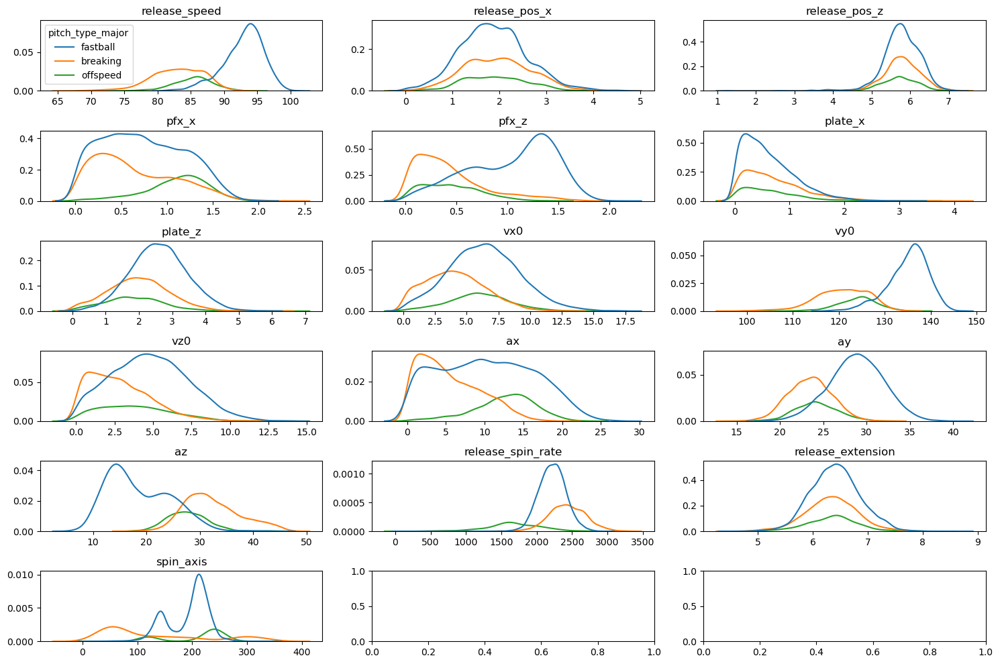

In [172]:
numeric_columns = data1.select_dtypes(include=['float64', 'int64'])
categorical_columns = data1.select_dtypes(include = ['object'])

num_columns = data1.shape[1]
fig, axes = plt.subplots(nrows=6, ncols=3, figsize=(15,10))

axes = axes.flatten()

# Plotting histograms for numeric columns
for i, column in enumerate(numeric_columns.columns):
    sns.kdeplot(data=data1, x=column, hue="pitch_type_major", ax=axes[i])
    axes[i].set_title(column)
    axes[i].set_ylabel('')

    axes[i].set_xlabel('')
    if i != 0:
        axes[i].legend_.remove()


plt.tight_layout()
plt.show()


In [ ]:
mi_list = []
x_list = []

x_vars = list(data2.columns[:-2])
x_vars.remove("pitch_type")

for i in x_vars:
    x_list.append(i)
    mi_list.append(calc_mi_v2([i],["pitch_outcome"],data2_noball)[0])

print(len(x_list), len(mi_list))
single_mi_df = pd.DataFrame({"Variable":x_list, "Mutual Information":mi_list})
single_mi_df.sort_values(by = "Mutual Information", ascending=False)

In [206]:
type(('ax','ay')) == tuple

True

In [225]:
def get_mi_df(x_vars, data):
    mi_list = []
    x_list = []

    for i in x_vars:
        x_list.append(i)
        #print(i)

        if type(i) == tuple:
            mi_list.append(calc_mi_v2(i,["pitch_outcome"],data)[0])
        else:    
            mi_list.append(calc_mi_v2([i],["pitch_outcome"],data)[0])

   #print(len(x_list), len(mi_list))
    single_mi_df = pd.DataFrame({"Variable":x_list, "Mutual Information":mi_list})
    single_mi_df = single_mi_df.sort_values(by = "Mutual Information", ascending=False).reset_index(drop=True)
    return single_mi_df

In [230]:
data1['pitch_type_major'].value_counts()

fastball    8918
breaking    4762
offspeed    1950
Name: pitch_type_major, dtype: int64

In [231]:
data2['pitch_type_major'].value_counts()

1    8918
0    4762
2    1950
3       1
Name: pitch_type_major, dtype: int64

In [232]:
data2[data2['pitch_type_major'] == 1]

,ax,ay,az,pfx_x,pfx_z,plate_x,plate_z,release_extension,release_pos_x,release_pos_z,...,release_spin_rate,spin_axis,vx0,vy0,vz0,pitch_type,p_throws,pitch_type_major,type,pitch_outcome
280,5,5,3,5,3,4,2,2,3,1,...,4,5,3,4,4,10,1,1,2,0
283,1,3,5,1,1,1,5,1,2,1,...,4,2,2,2,2,3,1,1,0,0
284,1,3,4,1,1,5,4,1,3,1,...,4,1,1,2,1,3,1,1,1,1
285,5,5,3,5,3,2,2,2,2,1,...,4,5,4,4,4,10,1,1,1,2
286,5,5,3,5,3,1,4,2,3,1,...,4,4,5,4,2,10,1,1,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24949,2,2,2,1,4,4,2,1,3,2,...,4,4,4,3,4,3,1,1,2,0
24950,3,3,2,3,4,3,3,2,3,2,...,4,4,3,3,3,4,1,1,1,1
24951,2,3,2,2,4,4,3,1,4,2,...,5,4,2,3,4,3,1,1,1,2
24954,4,3,2,3,4,2,4,1,3,2,...,4,4,4,4,3,4,1,1,1,2


In [245]:
#fastball
get_mi_df(x_vars, data2[data2['pitch_type_major'] == 1])

,Variable,Mutual Information
0,plate_x,0.072362
1,plate_z,0.037453
2,vz0,0.010490
3,vx0,0.007443
4,az,0.002948
5,pfx_z,0.002618
6,vy0,0.001620
7,release_speed,0.001486
8,release_spin_rate,0.001213
9,spin_axis,0.001104


In [235]:
get_mi_df(x_vars, data2[data2['pitch_type_major'] == 0])

,Variable,Mutual Information
0,plate_x,0.052277
1,plate_z,0.022472
2,vz0,0.008721
3,vx0,0.006844
4,pfx_z,0.001794
5,release_pos_x,0.001633
6,release_extension,0.001458
7,release_pos_z,0.001407
8,release_speed,0.001150
9,release_spin_rate,0.001106


In [236]:
get_mi_df(x_vars, data2[data2['pitch_type_major'] == 2])

,Variable,Mutual Information
0,plate_x,0.042047
1,plate_z,0.024293
2,vz0,0.014538
3,vx0,0.007514
4,release_pos_z,0.004260
5,vy0,0.004235
6,release_speed,0.003767
7,pfx_x,0.003422
8,ax,0.003007
9,pfx_z,0.002778


In [237]:
data2_noball['pitch_outcome'].value_counts()

2    4556
1    2844
0    2566
Name: pitch_outcome, dtype: int64

In [239]:
data2['pitch_outcome'].value_counts()

0    7980
2    4556
1    3095
Name: pitch_outcome, dtype: int64

In [240]:
data1['pitch_outcome'].value_counts()

negative    7980
positive    4556
neutral     3094
Name: pitch_outcome, dtype: int64

In [242]:
get_mi_df(combinations,data2[data2['pitch_type_major'] == 1] ).head(10)

,Variable,Mutual Information
0,"(plate_x, plate_z)",0.115295
1,"(plate_x, vz0)",0.084418
2,"(plate_x, vx0)",0.078417
3,"(az, plate_x)",0.077503
4,"(pfx_z, plate_x)",0.077212
5,"(plate_x, release_spin_rate)",0.076976
6,"(plate_x, vy0)",0.076516
7,"(plate_x, release_speed)",0.076432
8,"(pfx_x, plate_x)",0.076292
9,"(ay, plate_x)",0.075998


In [243]:
get_mi_df(combinations,data2[data2['pitch_type_major'] == 0] ).head(10)

,Variable,Mutual Information
0,"(plate_x, plate_z)",0.083773
1,"(plate_x, vz0)",0.066812
2,"(plate_x, vx0)",0.060598
3,"(plate_x, release_pos_z)",0.057068
4,"(ay, plate_x)",0.056735
5,"(plate_x, release_pos_x)",0.056733
6,"(ax, plate_x)",0.056716
7,"(plate_x, release_spin_rate)",0.056668
8,"(pfx_x, plate_x)",0.056317
9,"(pfx_z, plate_x)",0.056258
